In [1]:
import numpy as np 
import pandas as pd 
import matplotlib as mpl
import matplotlib.pyplot as plt 
import missingno as msno
import seaborn as sns 
import os

In [2]:
import matplotlib_inline.backend_inline

matplotlib_inline.backend_inline.set_matplotlib_formats("png2x")
# 테마 설정: "default", "classic", "dark_background", "fivethirtyeight", "seaborn"
mpl.style.use("fivethirtyeight")
# 이미지가 레이아웃 안으로 들어오도록 함
mpl.rcParams.update({"figure.constrained_layout.use": True})

In [3]:
import matplotlib.font_manager as fm
font_list = fm.findSystemFonts(fontpaths=None, fontext='ttf')
[fm.FontProperties(fname=font).get_name() for font in font_list if 'D2C' in font]
plt.rc('font', family='Malgun Gothic')
mpl.rcParams['axes.unicode_minus'] = False

In [4]:
DATASET_DIR = './'
load_dir = ''
file_name = 'BigCitiesHealth.csv'
RSLT_DIR = './processed/'
pvtb_dir = RSLT_DIR + 'pvtb/'

In [5]:
df_city = pd.read_csv("./BCHI_Cities.csv")

C:\Users\Post Scriptum\AppData\Local\Temp\ipykernel_21328\3158267263.py:1: DtypeWarning: Columns (15,18,31) have mixed types. Specify dtype option on import or set low_memory=False.
  df_city = pd.read_csv("./BCHI_Cities.csv")


## FUNCTIONS

- preprocess

In [6]:
def count_key_opt(data:pd.DataFrame,key,opt):
    rslt = dict()
    labels = data[key].unique()
    form = data[opt].value_counts().sort_values(ascending=False)
    form.iloc[:] = 0

    for feat in labels:
        cond = data[key]==feat
        val = form.copy()
        temp = data.loc[cond,opt].value_counts()
        val.loc[temp.index] = temp
        rslt[feat] = val

    return pd.DataFrame(rslt).T

- plot

In [7]:
import re

def choose_split_point(word_len,space,ths):
    # 윗 줄에 space 만큼 공백이 있고, 한 줄의 길이가 ths로 제한 되어있을 때
    # 어떤 지점에서 단어를 끊어줄지 정하기
    # |-------ths-------|
    # |-space-|---------|-space-|------| : word
    #         |-------ths-------|
    print(word_len,space,ths)
    if word_len < ths + space :
        if abs(word_len/2 -ths) <= abs(word_len/2-space) :
            return word_len-ths
        else :
            return word_len - space if word_len < 2 * space else space
    else :
        return ths if word_len - (ths + space) < 0.3 * ths else space

def minimize_seq_idx_np(domain:np.array,func):
    vfunc = np.vectorize(func)
    temp = np.argsort(vfunc(domain))
    return temp[0]

def modify_strlen_ths(last,new,ths=16):
    front = len(last)
    space = ths - (1+front)
    if len(new) < space :
        rslt = [last + ' ' + new]
    else :
        if len(new) < ths:
            rslt = [last, new]
        else:
            cut = choose_split_point(len(new),space-1,ths-1)
            new_h, new_e = new[:cut]+'-', new[cut:]
            if cut < ths-1 :
                rslt = modify_strlen_ths(last+' '+new_h,new_e)
            else :
                rslt = [last] + modify_strlen_ths(new_h,new_e) 
    return rslt

def str_cutter(sentnc, ths = 16):
    words= sentnc.split(' ')
    rslt, pnt = [''], 0
    while pnt < len(words):
        last = '' if len(rslt)==0 else rslt[-1]
        next_ele = modify_strlen_ths(last,words[pnt],ths)
        rslt = rslt[:-1] + next_ele
        pnt += 1
    return '\n'.join(rslt)[1:]
#알고리즘 때문에 맨 앞에 빈칸 하나 들어가게 되는 이슈 있음

print(str_cutter('Racial Segregation Indices | Racial Segregation, White and Hispanic', 13))



Racial
Segregation
Indices |
Racial
Segregation,
White and
Hispanic


In [8]:
def choose_plot_grid(n:int,r_max=8,c_max=17):
    rs = np.sqrt(n)
    r_min = np.ceil(n/c_max)
    sppt = np.arange(r_min,r_max+1) #need error process
    col_nums = np.ceil(n/sppt)
    res = col_nums * sppt -n
    min_idx = np.where(res==np.min(res))
    #TODO : if len(min_idx) > 1 : minimize abs(sppt-col_nums), col_nums
    return sppt[min_idx[0]], col_nums[min_idx[0]]


def plot_feat_hue(data:pd.DataFrame,hue_label_dict=None):
    num_r, num_c = choose_plot_grid(len(data))
    fig, axes = plt.subplots(num_r,num_c,figsize=(21,17),sharex=True,sharey=True)
    for n,ax in enumerate(axes.flatten()):
        plt.setp(ax.get_xticklabels(),ha = 'left',rotation = 90)
        if n >= len(data) : continue
        sns.barplot(x=data.iloc[n].index, y = data.iloc[n].values,ax =ax)
        feat_name = data.index[n]
        if hue_label_dict: color = 'b' if hue_label_dict[feat_name] else 'k'
        else : color = 'k'
        ax.set_xlabel(str_cutter(feat_name,20),loc='left',fontsize = 8.3,color=color)

    pass

## LOAD DATA

In [9]:
pvtb_name = 'pvtb_city_entire_ver0.csv'


pvtb_path = os.path.join(pvtb_dir,pvtb_name)
pvtb_entire = pd.read_csv(pvtb_path)

pvtb_entire

,geo_label_city,date_label,strata_race_label,strata_sex_label,Active Transportation | Riding Bike to Work,Active Transportation | Walking to Work,Air Pollution | Hazardous Air Quality,Air Pollution | Poor Air Quality,Birth Control | Teen Birth Control,Births | Low Birthweight,...,Substance Use | Adult Smoking,Substance Use | Drug Overdose Deaths,Substance Use | Opioid Overdose Deaths,Substance Use | Teen Alcohol,Substance Use | Teen Marijuana,Substance Use | Teen Smoking,Transportation | Drives Alone to Work,Transportation | Lack of Car,Transportation | Longer Driving Commute Time,Transportation | Public Transportation Use
0,Austin,2010,All,Both,1.458997,2.506039,2.191781,25.479452,NaN,7.836414,...,14.1,14.814379,5.316296,NaN,NaN,NaN,71.701852,7.104797,NaN,4.673879
1,Austin,2010,All,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,12.110401,4.224056,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Austin,2010,All,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,17.451652,6.417004,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Austin,2010,Asian/PI,Both,NaN,NaN,NaN,NaN,NaN,8.785406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Austin,2010,Asian/PI,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7275,Washington,2022,Hispanic,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,25.584642,21.067009,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7276,Washington,2022,Natives,Both,NaN,8.766234,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,19.237013,NaN,NaN,38.879870
7277,Washington,2022,White,Both,NaN,14.201808,NaN,NaN,NaN,5.574537,...,NaN,13.498547,8.887272,NaN,NaN,NaN,24.173919,NaN,NaN,21.684225
7278,Washington,2022,White,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,6.485127,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', 2000)

In [11]:
pvtb_entire

,geo_label_city,date_label,strata_race_label,strata_sex_label,Active Transportation | Riding Bike to Work,Active Transportation | Walking to Work,Air Pollution | Hazardous Air Quality,Air Pollution | Poor Air Quality,Birth Control | Teen Birth Control,Births | Low Birthweight,...,Substance Use | Adult Smoking,Substance Use | Drug Overdose Deaths,Substance Use | Opioid Overdose Deaths,Substance Use | Teen Alcohol,Substance Use | Teen Marijuana,Substance Use | Teen Smoking,Transportation | Drives Alone to Work,Transportation | Lack of Car,Transportation | Longer Driving Commute Time,Transportation | Public Transportation Use
0,Austin,2010,All,Both,1.458997,2.506039,2.191781,25.479452,NaN,7.836414,...,14.1,14.814379,5.316296,NaN,NaN,NaN,71.701852,7.104797,NaN,4.673879
1,Austin,2010,All,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,12.110401,4.224056,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Austin,2010,All,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,17.451652,6.417004,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Austin,2010,Asian/PI,Both,NaN,NaN,NaN,NaN,NaN,8.785406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Austin,2010,Asian/PI,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7275,Washington,2022,Hispanic,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,25.584642,21.067009,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7276,Washington,2022,Natives,Both,NaN,8.766234,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,19.237013,NaN,NaN,38.879870
7277,Washington,2022,White,Both,NaN,14.201808,NaN,NaN,NaN,5.574537,...,NaN,13.498547,8.887272,NaN,NaN,NaN,24.173919,NaN,NaN,21.684225
7278,Washington,2022,White,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,6.485127,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot: >

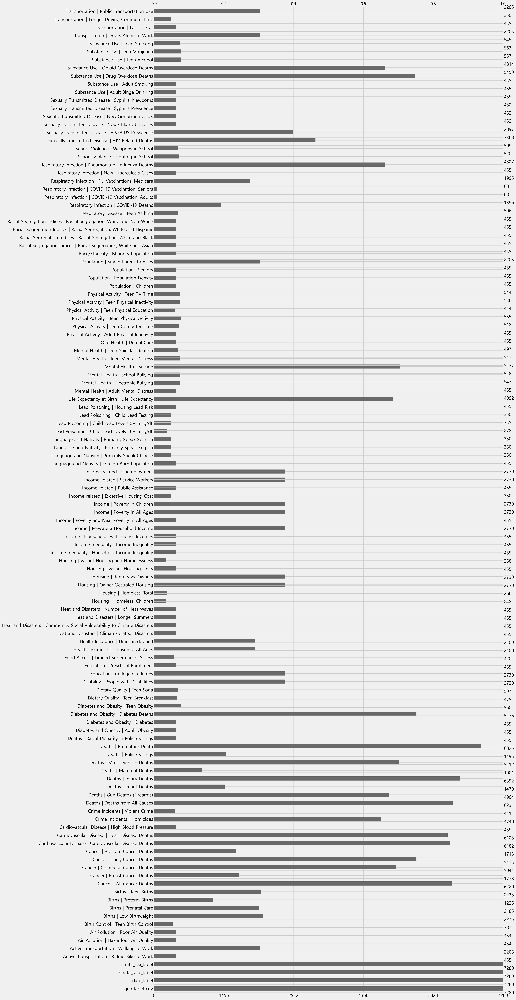

In [12]:
msno.bar(pvtb_entire)

<AxesSubplot: >

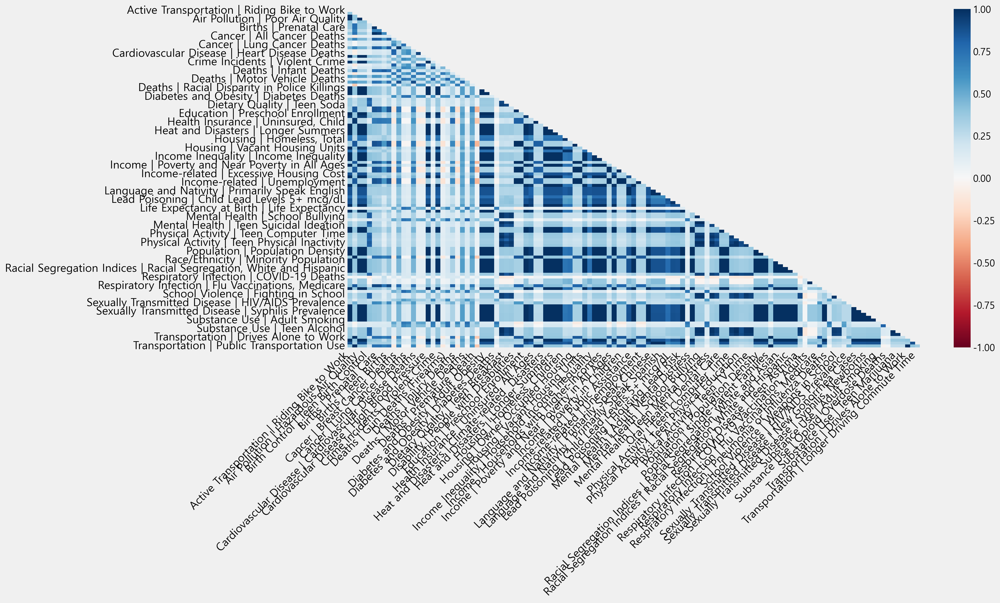

In [13]:
msno.heatmap(pvtb_entire, labels=False)

In [14]:
pvtb_entire_T = pvtb_entire.T
depvar_cand = (pvtb_entire_T[np.sum(pvtb_entire_T.isna(),axis=1) < 7280 * 0.33].index)

In [15]:
pvtb_entire_T

,0,1,2,3,4,5,6,7,8,9,...,7270,7271,7272,7273,7274,7275,7276,7277,7278,7279
geo_label_city,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin,...,Washington,Washington,Washington,Washington,Washington,Washington,Washington,Washington,Washington,Washington
date_label,2010,2010,2010,2010,2010,2010,2010,2010,2010,2010,...,2022,2022,2022,2022,2022,2022,2022,2022,2022,2022
strata_race_label,All,All,All,Asian/PI,Asian/PI,Asian/PI,Black,Black,Black,Hispanic,...,Black,Black,Black,Hispanic,Hispanic,Hispanic,Natives,White,White,White
strata_sex_label,Both,Female,Male,Both,Female,Male,Both,Female,Male,Both,...,Both,Female,Male,Both,Female,Male,Both,Both,Female,Male
Active Transportation | Riding Bike to Work,1.458997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Substance Use | Teen Smoking,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Transportation | Drives Alone to Work,71.701852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,40.725046,NaN,NaN,25.498413,NaN,NaN,19.237013,24.173919,NaN,NaN
Transportation | Lack of Car,7.104797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Transportation | Longer Driving Commute Time,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
indvar_cand = [col for col in pvtb_entire.columns.to_list() if col not in depvar_cand.to_list()]

In [17]:
for idx, cand in enumerate(indvar_cand):
    print(idx, cand)

0 Active Transportation | Riding Bike to Work
1 Active Transportation | Walking to Work
2 Air Pollution | Hazardous Air Quality
3 Air Pollution | Poor Air Quality
4 Birth Control | Teen Birth Control
5 Births | Low Birthweight
6 Births | Prenatal Care
7 Births | Preterm Births
8 Births | Teen Births
9 Cancer | Breast Cancer Deaths
10 Cancer | Prostate Cancer Deaths
11 Cardiovascular Disease | High Blood Pressure
12 Crime Incidents | Homicides
13 Crime Incidents | Violent Crime
14 Deaths | Infant Deaths
15 Deaths | Maternal Deaths
16 Deaths | Police Killings
17 Deaths | Racial Disparity in Police Killings
18 Diabetes and Obesity | Adult Obesity
19 Diabetes and Obesity | Diabetes
20 Diabetes and Obesity | Teen Obesity
21 Dietary Quality | Teen Breakfast
22 Dietary Quality | Teen Soda
23 Disability | People with Disabilities
24 Education | College Graduates
25 Education | Preschool Enrollment
26 Food Access | Limited Supermarket Access
27 Health Insurance | Uninsured, All Ages
28 Health I

In [18]:
depvar_cand = depvar_cand.to_list()

In [19]:
depvar_cand = depvar_cand[4:]

In [20]:
depvar_cand

['Cancer | All Cancer Deaths',
 'Cancer | Colorectal Cancer Deaths',
 'Cancer | Lung Cancer Deaths',
 'Cardiovascular Disease | Cardiovascular Disease Deaths',
 'Cardiovascular Disease | Heart Disease Deaths',
 'Deaths | Deaths from All Causes',
 'Deaths | Gun Deaths (Firearms)',
 'Deaths | Injury Deaths',
 'Deaths | Motor Vehicle Deaths',
 'Deaths | Premature Death',
 'Diabetes and Obesity | Diabetes Deaths',
 'Life Expectancy at Birth | Life Expectancy',
 'Mental Health | Suicide',
 'Substance Use | Drug Overdose Deaths']

In [21]:
# Heuristic approach
cancer_cand = []
cardio_cand = [11,18,19,20,21,22]
diabetes_cand = [18,19,20,21,22,26]
expectancy_cand = []
suicide_cand = []
drug_cand = []
other_deaths_cand = [12,13,14,15,16,27,28,29,30,32]

### 독립변수 파악 방안
### 가장 단순한 방법 = Heuristic
### 실제 비슷한 연구에서 뭘 사용하는지?

``` ['Cancer | All Cancer Deaths',
 'Cancer | Colorectal Cancer Deaths',
 'Cancer | Lung Cancer Deaths',
 'Cardiovascular Disease | Cardiovascular Disease Deaths',
 'Cardiovascular Disease | Heart Disease Deaths',
 'Deaths | Deaths from All Causes',
 'Deaths | Gun Deaths (Firearms)',
 'Deaths | Injury Deaths',
 'Deaths | Motor Vehicle Deaths',
 'Deaths | Premature Death',
 'Diabetes and Obesity | Diabetes Deaths',
 'Life Expectancy at Birth | Life Expectancy',
 'Mental Health | Suicide',
 'Substance Use | Drug Overdose Deaths'] ```

# 통계적 확인
# 결측치? 이상치?가 많을 경우 사용하기 힘들어짐
# 분포 (특정 도시에만? 특정 년도에만? 특정 계층에만?)
# CI 값? - 



<AxesSubplot: >

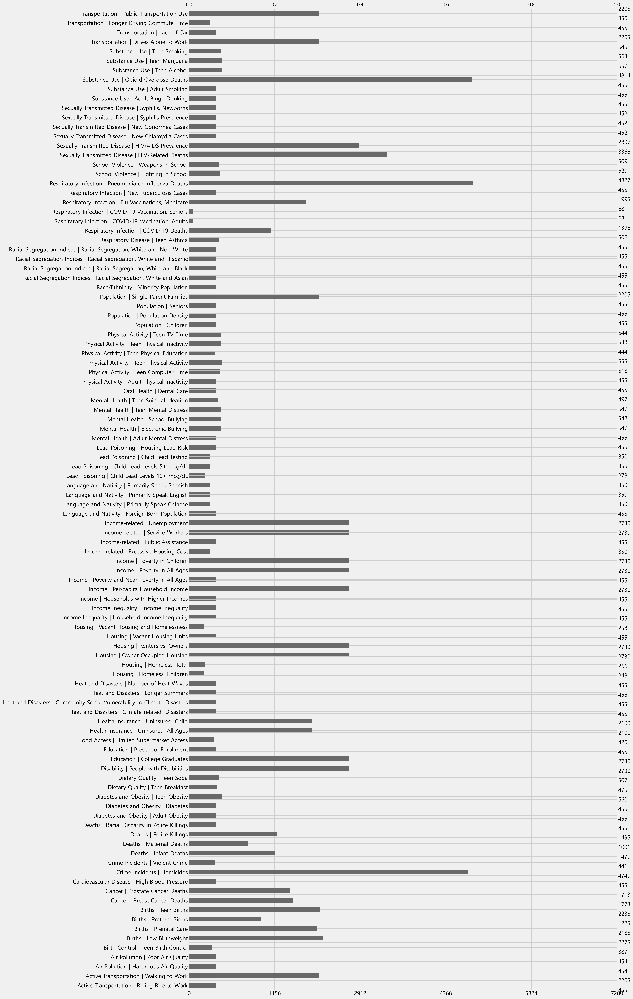

In [22]:
## 통계적 확인

msno.bar(pvtb_entire[indvar_cand])

### 기본형("All" / "Both") 에 대한 결측치 확인

<AxesSubplot: >

t:\miniconda3\envs\kdt\lib\site-packages\IPython\core\events.py:89: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  func(*args, **kwargs)
t:\miniconda3\envs\kdt\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.canvas.print_figure(bytes_io, **kw)


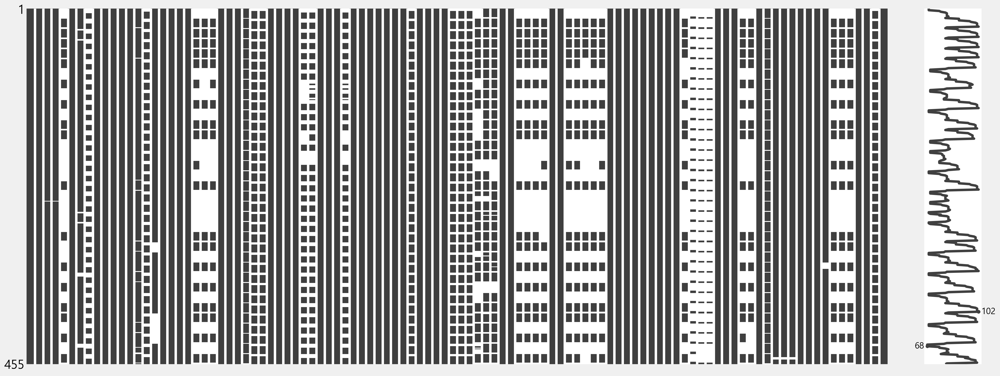

In [23]:
msno.matrix(pvtb_entire[(pvtb_entire["strata_race_label"] == "All") & (pvtb_entire["strata_sex_label"] == "Both")][indvar_cand])

<AxesSubplot: >

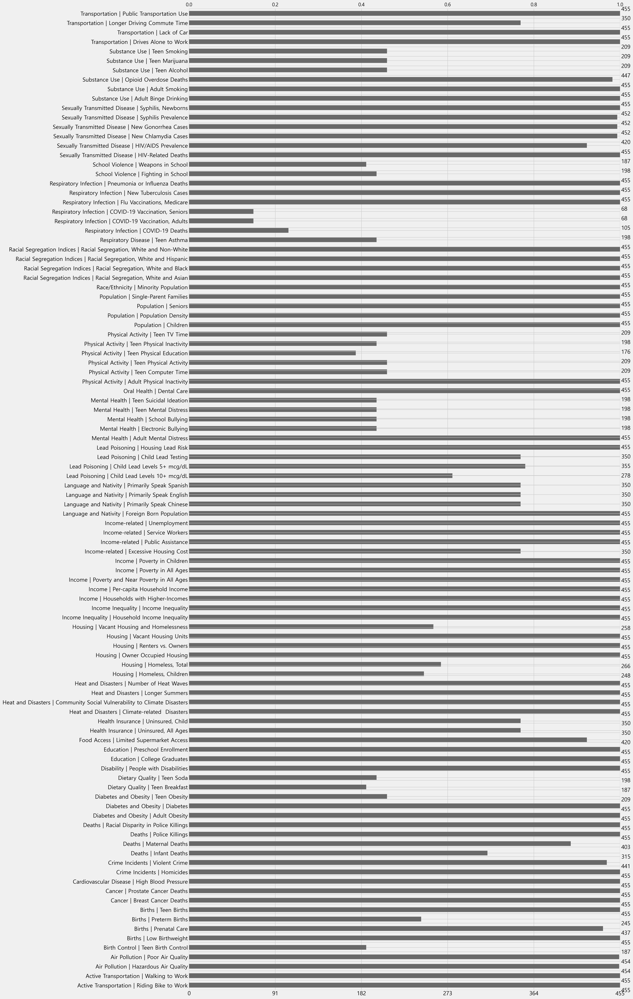

In [24]:
msno.bar(pvtb_entire[(pvtb_entire["strata_race_label"] == "All") & (pvtb_entire["strata_sex_label"] == "Both")][indvar_cand])

In [25]:
CI_somena_index = ["Physical Activity | Teen Computer Time",
"Physical Activity | Teen Physical Activity",
"Physical Activity | Teen TV Time",
"Respiratory Disease | Teen Asthma",
"Substance Use | Teen Alcohol",
"Substance Use | Teen Marijuana",
"Substance Use | Teen Smoking",
"Diabetes and Obesity | Teen Obesity"]

In [26]:
df_default = pvtb_entire[(pvtb_entire["strata_race_label"] == "All") & (pvtb_entire["strata_sex_label"] == "Both")][indvar_cand]

# null proportion

df_nullprop = pd.DataFrame({'majority_missing': (df_default.isna().sum() / len(df_default))})

df_majornull = pd.DataFrame({'majority_missing': (df_default.isna().sum() / len(df_default)) > 0.5})
df_majornull = df_majornull[df_majornull].dropna()

df_majornull

,majority_missing
Birth Control | Teen Birth Control,True
Diabetes and Obesity | Teen Obesity,True
Dietary Quality | Teen Breakfast,True
Dietary Quality | Teen Soda,True
Mental Health | Electronic Bullying,True
Mental Health | School Bullying,True
Mental Health | Teen Mental Distress,True
Mental Health | Teen Suicidal Ideation,True
Physical Activity | Teen Computer Time,True
Physical Activity | Teen Physical Activity,True


In [27]:
df_nullprop.columns

Index(['majority_missing'], dtype='object')

In [28]:
df_nullprop[df_nullprop["majority_missing"] > 0.5].sort_values(by="majority_missing")
#상위 7 = 0 < CI null < 1 인 19개의 컬럼 중 최종 후보 8에 포함

,majority_missing
Substance Use | Teen Smoking,0.540659
Diabetes and Obesity | Teen Obesity,0.540659
Substance Use | Teen Alcohol,0.540659
Physical Activity | Teen Computer Time,0.540659
Physical Activity | Teen Physical Activity,0.540659
Substance Use | Teen Marijuana,0.540659
Physical Activity | Teen TV Time,0.540659
Dietary Quality | Teen Soda,0.564835
Mental Health | Electronic Bullying,0.564835
Mental Health | School Bullying,0.564835


In [29]:
remove_candidate_1 = df_nullprop[df_nullprop["majority_missing"] > 0.5].sort_values(by="majority_missing").tail(15).index

In [30]:
not_CI_somena_index = list(set(df_majornull.index.to_list()) - set(CI_somena_index))

In [31]:
not_CI_somena_index

['School Violence | Fighting in School',
 'Physical Activity | Teen Physical Education',
 'Dietary Quality | Teen Soda',
 'Respiratory Infection | COVID-19 Vaccination, Seniors',
 'Birth Control | Teen Birth Control',
 'School Violence | Weapons in School',
 'Dietary Quality | Teen Breakfast',
 'Respiratory Infection | COVID-19 Vaccination, Adults',
 'Mental Health | School Bullying',
 'Mental Health | Teen Suicidal Ideation',
 'Physical Activity | Teen Physical Inactivity',
 'Mental Health | Electronic Bullying',
 'Mental Health | Teen Mental Distress',
 'Respiratory Infection | COVID-19 Deaths']

In [32]:
# df_teen = df_city[(df_city["metric_label"].isin(not_CI_somena_index)) & (df_city["strata_race_label"] == "All") & (df_city["strata_sex_label"] == "Both")]

pvtb_entire[(pvtb_entire["strata_race_label" ]== "All") & (pvtb_entire["strata_sex_label"] == "Both")][["geo_label_city"] + not_CI_somena_index].groupby("geo_label_city").count()

# fig, ax = plt.subplots(figsize=(20,20))
# table_teen.plot.bar(ax=ax)

,School Violence | Fighting in School,Physical Activity | Teen Physical Education,Dietary Quality | Teen Soda,"Respiratory Infection | COVID-19 Vaccination, Seniors",Birth Control | Teen Birth Control,School Violence | Weapons in School,Dietary Quality | Teen Breakfast,"Respiratory Infection | COVID-19 Vaccination, Adults",Mental Health | School Bullying,Mental Health | Teen Suicidal Ideation,Physical Activity | Teen Physical Inactivity,Mental Health | Electronic Bullying,Mental Health | Teen Mental Distress,Respiratory Infection | COVID-19 Deaths
geo_label_city,,,,,,,,,,,,,,
Austin,0,0,0,2,0,0,0,2,0,0,0,0,0,3
Baltimore,11,11,11,2,11,11,11,2,11,11,11,11,11,3
Boston,11,11,11,2,11,11,11,2,11,11,11,11,11,3
Charlotte,11,11,11,2,11,11,11,2,11,11,11,11,11,3
Chicago,11,11,11,2,11,11,11,2,11,11,11,11,11,3
Cleveland,11,0,11,2,11,11,11,2,11,11,11,11,11,3
Columbus,0,0,0,2,0,0,0,2,0,0,0,0,0,3
Dallas,11,11,11,2,11,11,0,2,11,11,11,11,11,3
Denver,0,0,0,2,0,0,0,2,0,0,0,0,0,3


In [33]:
pvtb_entire[(pvtb_entire["strata_race_label" ]== "All") & (pvtb_entire["strata_sex_label"] == "Both")][["date_label"] + not_CI_somena_index].groupby("date_label").count()

,School Violence | Fighting in School,Physical Activity | Teen Physical Education,Dietary Quality | Teen Soda,"Respiratory Infection | COVID-19 Vaccination, Seniors",Birth Control | Teen Birth Control,School Violence | Weapons in School,Dietary Quality | Teen Breakfast,"Respiratory Infection | COVID-19 Vaccination, Adults",Mental Health | School Bullying,Mental Health | Teen Suicidal Ideation,Physical Activity | Teen Physical Inactivity,Mental Health | Electronic Bullying,Mental Health | Teen Mental Distress,Respiratory Infection | COVID-19 Deaths
date_label,,,,,,,,,,,,,,
2010,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2011,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2012,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2013,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2014,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2015,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2016,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2017,18,16,18,0,17,17,17,0,18,18,18,18,18,0
2018,18,16,18,0,17,17,17,0,18,18,18,18,18,0


In [34]:
display(df_city[df_city["metric_label"].isin(CI_somena_index)]["strata_race_label"].value_counts())
display(df_city[df_city["metric_label"].isin(CI_somena_index)]["strata_sex_label"].value_counts())

All         2673
Hispanic     498
Black        447
White        410
Asian/PI     320
Name: strata_race_label, dtype: int64

Both      3336
Male       506
Female     506
Name: strata_sex_label, dtype: int64

In [35]:
display(df_city[df_city["metric_label"].isin(not_CI_somena_index)]["strata_race_label"].value_counts())
display(df_city[df_city["metric_label"].isin(not_CI_somena_index)]["strata_sex_label"].value_counts())

All         3904
Hispanic     901
Black        874
White        812
Asian/PI     560
Name: strata_race_label, dtype: int64

Both      4818
Male      1131
Female    1102
Name: strata_sex_label, dtype: int64

In [36]:
len(indvar_cand)

104

In [82]:
# 기본형 데이터 의 연간 결측분포

fig, axes = plt.subplots(13,8,figsize=(60,60), sharey=True)
# 각 metric 별 연간 결측치 갯수 + 1 (na = 0)
for i in range(104):
    curr_metric = indvar_cand[i]
    ax = axes[i//8][i%8]
    year_counts = df_city[(df_city["metric_label"].isin(indvar_cand)) & (df_city["strata_race_label"] == "All") & (df_city["strata_sex_label"] == "Both") & (df_city["metric_label"] == curr_metric)].groupby("metric_label")["date_label"].value_counts()

    year_counts = year_counts.to_frame().reset_index(0).drop(columns="metric_label").rename(columns={"date_label": "count"})
    year_counts.loc[:,"count"] = 36 - year_counts["count"] #na와 0을 구분하기 위해 진짜 0이면 1이 되게 36에서 빼줌

    full_index = pd.DataFrame(data=[np.nan] * len(df_city["date_label"].unique()), index=np.sort(df_city["date_label"].unique()), columns=["count"])
    missing_df = pd.DataFrame(index = [idx for idx in full_index.index if idx not in year_counts.index], columns = full_index.columns)
    missing_df.index.name = "date_label"
    year_counts = pd.concat([year_counts,missing_df]).sort_index()

    year_counts.plot.bar(ax=ax)
    ax.set(xlabel="date",ylabel="count", title=f"Year-{curr_metric}")
    # ax.bar(x=df_city["date_label"].unique(), height=["count"])




In [84]:
fig, axes = plt.subplots(13,8,figsize=(60,60),sharey=True)
for i in range(104):
    curr_metric = indvar_cand[i]
    ax = axes[i//8][i%8]
    city_counts = df_city[(df_city["metric_label"].isin(indvar_cand)) & (df_city["strata_race_label"] == "All") & (df_city["strata_sex_label"] == "Both") & (df_city["metric_label"] == curr_metric)].groupby("metric_label")["geo_label_city"].value_counts()

    city_counts = city_counts.to_frame().reset_index(0).drop(columns="metric_label").rename(columns={"geo_label_city": "count"})
    city_counts.loc[:,"count"] = 14 - city_counts["count"]

    full_index = pd.DataFrame(data=[np.nan] * len(df_city["geo_label_city"].unique()), index=np.sort(df_city["geo_label_city"].unique()), columns=["count"])
    missing_df = pd.DataFrame(index = [idx for idx in full_index.index if idx not in year_counts.index], columns = full_index.columns)
    missing_df.index.name = "geo_label_city"
    city_counts = pd.concat([city_counts,missing_df]).sort_index()

    city_counts.plot.bar(ax=ax)
    ax.set(xlabel="date",ylabel="count", title=f"City-{curr_metric}")
    # ax.bar(x=df_city["date_label"].unique(), height=["count"])


In [99]:
remove_candidate_year = []
remove_candidate_city = []
for i in range(104):
    curr_metric = indvar_cand[i]
    year_counts = df_city[(df_city["metric_label"].isin(indvar_cand)) & (df_city["strata_race_label"] == "All") & (df_city["strata_sex_label"] == "Both") & (df_city["metric_label"] == curr_metric)].groupby("metric_label")["date_label"].value_counts()
    city_counts = df_city[(df_city["metric_label"].isin(indvar_cand)) & (df_city["strata_race_label"] == "All") & (df_city["strata_sex_label"] == "Both") & (df_city["metric_label"] == curr_metric)].groupby("metric_label")["geo_label_city"].value_counts()

    if year_counts.var() != 0:
        remove_candidate_year.append((curr_metric,year_counts.mean(), year_counts.var(), year_counts.std()/year_counts.mean()))
    if city_counts.var() != 0:
        remove_candidate_city.append((curr_metric,city_counts.mean(), city_counts.var(), city_counts.std()/city_counts.mean()))
    # ax.bar(x=df_city["date_label"].unique(), height=["count"])

In [100]:
remove_candidate_year

[('Air Pollution | Hazardous Air Quality',
  34.92307692307692,
  0.07692307692307691,
  0.007941742897497774),
 ('Air Pollution | Poor Air Quality',
  34.92307692307692,
  0.07692307692307691,
  0.007941742897497774),
 ('Births | Prenatal Care',
  33.61538461538461,
  4.923076923076923,
  0.06600551534030187),
 ('Crime Incidents | Violent Crime',
  33.92307692307692,
  10.91025641025641,
  0.09736934343124568),
 ('Housing | Homeless, Total', 33.25, 0.5, 0.02126636935899391),
 ('Housing | Vacant Housing and Homelessness',
  32.25,
  0.5,
  0.02192579166469915),
 ('Lead Poisoning | Child Lead Levels 10+ mcg/dL',
  25.272727272727273,
  0.21818181818181817,
  0.018482349034050542),
 ('Lead Poisoning | Child Lead Levels 5+ mcg/dL',
  32.27272727272727,
  0.41818181818181815,
  0.020037655485947874),
 ('Lead Poisoning | Child Lead Testing',
  31.818181818181817,
  0.16363636363636364,
  0.012713483120735423),
 ('Sexually Transmitted Disease | New Chlamydia Cases',
  34.76923076923077,
  0.

In [101]:
display(remove_candidate_city)
# remove_candidate_city = [cand for cand in remove_candidate_city ]

[('Air Pollution | Hazardous Air Quality',
  12.971428571428572,
  0.02857142857142857,
  0.01303101273810488),
 ('Air Pollution | Poor Air Quality',
  12.971428571428572,
  0.02857142857142857,
  0.01303101273810488),
 ('Births | Prenatal Care',
  12.485714285714286,
  1.6689075630252102,
  0.10346721245319788),
 ('Crime Incidents | Violent Crime',
  12.6,
  0.4235294117647059,
  0.051650109004441946),
 ('Housing | Homeless, Total',
  7.823529411764706,
  0.5739750445632799,
  0.09683754830928092),
 ('Housing | Vacant Housing and Homelessness',
  7.818181818181818,
  0.5909090909090909,
  0.09832287514702187),
 ('Lead Poisoning | Child Lead Levels 10+ mcg/dL',
  10.296296296296296,
  4.293447293447294,
  0.20124358074609544),
 ('Lead Poisoning | Child Lead Levels 5+ mcg/dL',
  10.757575757575758,
  0.8143939393939393,
  0.08388858198623445),
 ('Lead Poisoning | Child Lead Testing',
  10.9375,
  0.06048387096774194,
  0.022485457226878388),
 ('Sexually Transmitted Disease | New Chlamyd

In [120]:
list(map(lambda x: x[0],remove_candidate_city))

['Air Pollution | Hazardous Air Quality',
 'Air Pollution | Poor Air Quality',
 'Births | Prenatal Care',
 'Crime Incidents | Violent Crime',
 'Housing | Homeless, Total',
 'Housing | Vacant Housing and Homelessness',
 'Lead Poisoning | Child Lead Levels 10+ mcg/dL',
 'Lead Poisoning | Child Lead Levels 5+ mcg/dL',
 'Lead Poisoning | Child Lead Testing',
 'Sexually Transmitted Disease | New Chlamydia Cases',
 'Sexually Transmitted Disease | New Gonorrhea Cases',
 'Sexually Transmitted Disease | Syphilis Prevalence',
 'Substance Use | Opioid Overdose Deaths']

C:\Users\Post Scriptum\AppData\Local\Temp\ipykernel_21328\1081960102.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=90, ha='right')
C:\Users\Post Scriptum\AppData\Local\Temp\ipykernel_21328\1081960102.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=90, ha='right')


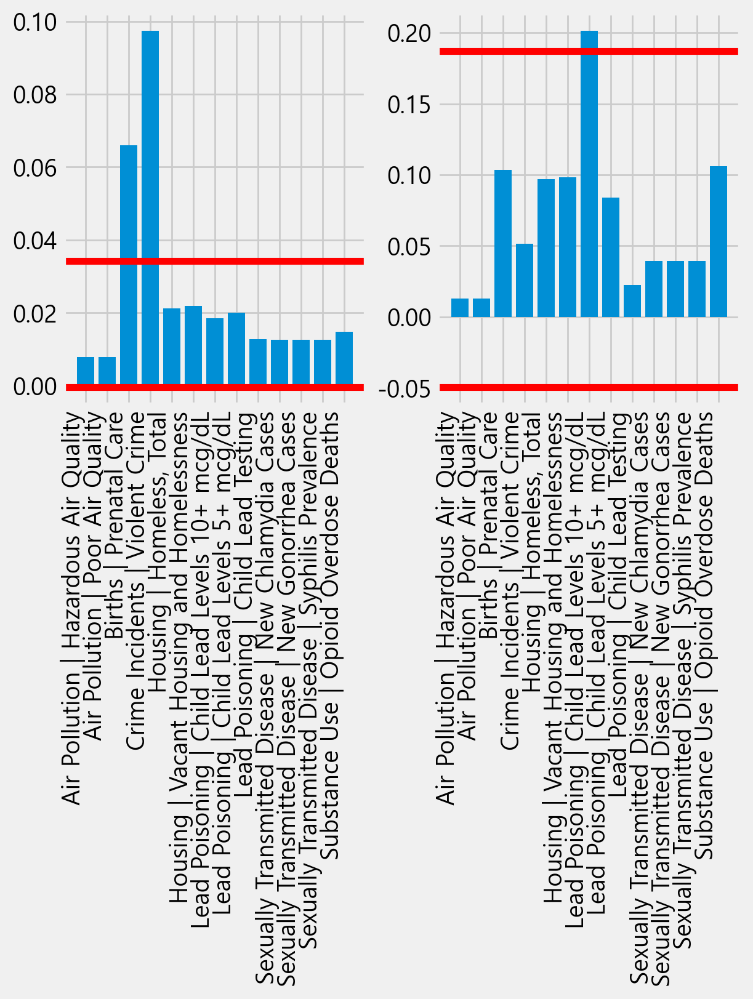

In [119]:
fig, ax = plt.subplots(1,2,figsize=(6,8))

year_cvs = list(map(lambda x: x[3],remove_candidate_year))
city_cvs = list(map(lambda x: x[3],remove_candidate_city))

ax[0].bar(x=list(map(lambda x: x[0],remove_candidate_year)),height = year_cvs)
ax[1].bar(x=list(map(lambda x: x[0],remove_candidate_city)),height = city_cvs)

np.subtract(*np.percentile(year_cvs, [75 ,25]))

ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=90, ha='right')
ax[0].axhline(y = np.percentile(year_cvs,75) + 1.5 * np.subtract(*np.percentile(year_cvs, [75 ,25])), color='red')
ax[0].axhline(y = np.percentile(year_cvs,25) - 1.5 * np.subtract(*np.percentile(year_cvs, [75 ,25])), color='red')
# ax[0].axhline(y = np.mean(year_cvs) + 2 * np.std(year_cvs), color='orange')
# ax[0].axhline(y = np.mean(year_cvs) - 2 * np.std(year_cvs), color='orange')
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=90, ha='right')
ax[1].axhline(y = np.percentile(city_cvs,75) + 1.5 * np.subtract(*np.percentile(city_cvs, [75 ,25])), color='red')
ax[1].axhline(y = np.percentile(city_cvs,25) - 1.5 * np.subtract(*np.percentile(city_cvs, [75 ,25])), color='red')

# ax[1].axhline(y = np.mean(city_cvs) + 2 * np.std(city_cvs), color='orange')
# ax[1].axhline(y = np.mean(city_cvs) - 2 * np.std(city_cvs), color='orange')

In [115]:
remove_candidate_1

Index(['Dietary Quality | Teen Soda', 'Mental Health | Electronic Bullying',
       'Mental Health | School Bullying',
       'Mental Health | Teen Mental Distress',
       'Mental Health | Teen Suicidal Ideation',
       'Physical Activity | Teen Physical Inactivity',
       'Respiratory Disease | Teen Asthma',
       'School Violence | Fighting in School',
       'School Violence | Weapons in School',
       'Birth Control | Teen Birth Control',
       'Dietary Quality | Teen Breakfast',
       'Physical Activity | Teen Physical Education',
       'Respiratory Infection | COVID-19 Deaths',
       'Respiratory Infection | COVID-19 Vaccination, Adults',
       'Respiratory Infection | COVID-19 Vaccination, Seniors'],
      dtype='object')

In [121]:
remove_candidate = remove_candidate_1.to_list() + ['Births | Prenatal Care','Crime Incidents | Violent Crime'] + ['Lead Poisoning | Child Lead Levels 10+ mcg/dL','Lead Poisoning | Child Lead Levels 5+ mcg/dL','Lead Poisoning | Child Lead Testing']

In [41]:
# df = pd.read_csv("./BigCitiesHealth.csv")

# df["metric_label"] = df["metric_subcat_label"]+' | '+df["metric_item_label"] 

# cond0 = df['geo_label_city'] == 'U.S. Total'

# df_US = df.loc[cond0].copy()
# df_city = df.loc[~cond0].copy()

# df_city.to_csv("./BCHI_Cities.csv")

In [122]:
remove_candidate

['Dietary Quality | Teen Soda',
 'Mental Health | Electronic Bullying',
 'Mental Health | School Bullying',
 'Mental Health | Teen Mental Distress',
 'Mental Health | Teen Suicidal Ideation',
 'Physical Activity | Teen Physical Inactivity',
 'Respiratory Disease | Teen Asthma',
 'School Violence | Fighting in School',
 'School Violence | Weapons in School',
 'Birth Control | Teen Birth Control',
 'Dietary Quality | Teen Breakfast',
 'Physical Activity | Teen Physical Education',
 'Respiratory Infection | COVID-19 Deaths',
 'Respiratory Infection | COVID-19 Vaccination, Adults',
 'Respiratory Infection | COVID-19 Vaccination, Seniors',
 'Births | Prenatal Care',
 'Crime Incidents | Violent Crime',
 'Lead Poisoning | Child Lead Levels 10+ mcg/dL',
 'Lead Poisoning | Child Lead Levels 5+ mcg/dL',
 'Lead Poisoning | Child Lead Testing']

In [129]:
pvtb_entire.loc[:,~pvtb_entire.columns.isin(remove_candidate)].corr()

C:\Users\Post Scriptum\AppData\Local\Temp\ipykernel_21328\706457938.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  pvtb_entire.loc[:,~pvtb_entire.columns.isin(remove_candidate)].corr()


,date_label,Active Transportation | Riding Bike to Work,Active Transportation | Walking to Work,Air Pollution | Hazardous Air Quality,Air Pollution | Poor Air Quality,Births | Low Birthweight,Births | Preterm Births,Births | Teen Births,Cancer | All Cancer Deaths,Cancer | Breast Cancer Deaths,...,Substance Use | Adult Smoking,Substance Use | Drug Overdose Deaths,Substance Use | Opioid Overdose Deaths,Substance Use | Teen Alcohol,Substance Use | Teen Marijuana,Substance Use | Teen Smoking,Transportation | Drives Alone to Work,Transportation | Lack of Car,Transportation | Longer Driving Commute Time,Transportation | Public Transportation Use
date_label,1.000000,-0.079189,-0.052581,-0.093636,-0.198241,0.078354,0.105102,-0.394742,-0.192205,-0.173687,...,-0.253987,0.388264,0.398598,-0.403621,-0.031905,-0.587235,-0.123015,-0.050493,0.017702,-0.102649
Active Transportation | Riding Bike to Work,-0.079189,1.000000,0.636439,-0.211371,-0.345512,-0.373292,-0.520026,-0.397532,-0.019015,-0.117807,...,-0.309799,0.020360,-0.001669,-0.096383,0.316842,-0.169938,-0.613753,0.376155,0.249721,0.489873
Active Transportation | Walking to Work,-0.052581,0.636439,1.000000,-0.239021,-0.320931,-0.152282,-0.357871,-0.350759,-0.181995,-0.253649,...,-0.185993,0.090208,0.139442,-0.050350,-0.009728,-0.042376,-0.790778,0.834229,0.536967,0.655216
Air Pollution | Hazardous Air Quality,-0.093636,-0.211371,-0.239021,1.000000,0.759784,-0.201265,-0.169208,0.026255,-0.104602,0.000398,...,-0.106385,-0.218628,-0.215956,0.066022,-0.218250,-0.010728,0.193977,-0.206582,0.209299,-0.167263
Air Pollution | Poor Air Quality,-0.198241,-0.345512,-0.320931,0.759784,1.000000,-0.041633,0.002728,0.231379,0.056079,0.154194,...,0.086641,-0.238520,-0.246028,0.137385,-0.114086,0.116138,0.326896,-0.246343,0.099432,-0.240327
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Substance Use | Teen Smoking,-0.587235,-0.169938,-0.042376,-0.010728,0.116138,-0.241834,-0.121997,0.220577,0.154166,0.055273,...,0.018856,-0.167822,-0.194631,0.734420,0.338699,1.000000,0.150274,-0.190221,-0.160377,-0.093474
Transportation | Drives Alone to Work,-0.123015,-0.613753,-0.790778,0.193977,0.326896,0.124041,0.314850,0.337453,0.251545,0.255524,...,0.355894,-0.084937,-0.114599,0.151800,-0.021857,0.150274,1.000000,-0.851960,-0.684532,-0.875074
Transportation | Lack of Car,-0.050493,0.376155,0.834229,-0.206582,-0.246343,0.212264,-0.014721,-0.190402,0.058099,0.049404,...,0.076463,0.207293,0.240410,-0.289585,0.023347,-0.190221,-0.851960,1.000000,0.606488,0.934949
Transportation | Longer Driving Commute Time,0.017702,0.249721,0.536967,0.209299,0.099432,-0.238009,-0.369892,-0.367794,-0.361288,-0.225169,...,-0.403083,-0.129783,-0.109649,-0.279711,-0.204570,-0.160377,-0.684532,0.606488,1.000000,0.707197


In [127]:
pvtb_entire

,geo_label_city,date_label,strata_race_label,strata_sex_label,Active Transportation | Riding Bike to Work,Active Transportation | Walking to Work,Air Pollution | Hazardous Air Quality,Air Pollution | Poor Air Quality,Birth Control | Teen Birth Control,Births | Low Birthweight,...,Substance Use | Adult Smoking,Substance Use | Drug Overdose Deaths,Substance Use | Opioid Overdose Deaths,Substance Use | Teen Alcohol,Substance Use | Teen Marijuana,Substance Use | Teen Smoking,Transportation | Drives Alone to Work,Transportation | Lack of Car,Transportation | Longer Driving Commute Time,Transportation | Public Transportation Use
0,Austin,2010,All,Both,1.458997,2.506039,2.191781,25.479452,NaN,7.836414,...,14.1,14.814379,5.316296,NaN,NaN,NaN,71.701852,7.104797,NaN,4.673879
1,Austin,2010,All,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,12.110401,4.224056,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Austin,2010,All,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,17.451652,6.417004,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Austin,2010,Asian/PI,Both,NaN,NaN,NaN,NaN,NaN,8.785406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Austin,2010,Asian/PI,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7275,Washington,2022,Hispanic,Male,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,25.584642,21.067009,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7276,Washington,2022,Natives,Both,NaN,8.766234,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,19.237013,NaN,NaN,38.879870
7277,Washington,2022,White,Both,NaN,14.201808,NaN,NaN,NaN,5.574537,...,NaN,13.498547,8.887272,NaN,NaN,NaN,24.173919,NaN,NaN,21.684225
7278,Washington,2022,White,Female,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,6.485127,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
